# Demo of analysing OpenPilot behaviours in Carla town with a leading vehicle:

This Jupyter notebook presents the OpenPilot software's behaviour within the Carla Simulator environment when there is a leading vehicle.  

Calling libraries used in the analysis of recorded data from OpenPilot.

In [5]:
"""
These pips you may need to download them, even though they have been included in 
the conda environment mentioned in the run instructions . 
"""
#!pip install -U augly[av]
#!pip install python3-magic

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime, timedelta
from IPython.display import display, HTML
from base64 import b64encode
import gc
gc.collect()

2889

 Loading data into a panda and using data frames depending on the data source type, i.e CSV files.

In [8]:
# You may need to change this based on the location of data 
#main_path = 'D:/OneDrive - University of Southampton/dataSample/town04carla/data'
main_path = '/Users/fahad/OneDrive - University of Southampton/carla_openpilot/OpenpilotWithCarla/openpilot/data'
# names of CSV headers in data folder
headers_lead_names = ['time','is_openpilot_engaged','target position','LeadingVPosition','currentspeed','currentVelocity'
                     , 'current_Steer', 'old_Steer','steer_rate_limit', 'leftLaneProb', 'rightLaneProb', 'desiredPathProb', 'HasLead'
                     , 'DistanceToLead', 'specifyCruise', 'awarenessStatus']


# function  to read CSV file in panda frames
def readCSVFile (filemame, withLead):
    dataFrame =  pd.read_csv(main_path + filemame,sep=',',names=headers_lead_names, index_col=False)
    return dataFrame

In [9]:
df_leadV_clearW_30 = readCSVFile('/withLeadingVehicle/clear/30/30.csv',True)
df_leadV_clearW_40 = readCSVFile('/withLeadingVehicle/clear/40/40.csv',True)
df_leadV_clearW_50 = readCSVFile('/withLeadingVehicle/clear/50/50.csv',True)

df_leadV_rainW_30 = readCSVFile('/withLeadingVehicle/rain/30/30.csv',True)
df_leadV_rainW_40 = readCSVFile('/withLeadingVehicle/rain/40/40.csv',True)
df_leadV_rainW_50 = readCSVFile('/withLeadingVehicle/rain/50/50.csv',True)

In [11]:
df_leadV_clearW_30

,time,is_openpilot_engaged,target position,LeadingVPosition,currentspeed,currentVelocity,current_Steer,old_Steer,steer_rate_limit,leftLaneProb,rightLaneProb,desiredPathProb,HasLead,DistanceToLead,specifyCruise,awarenessStatus
0,time,is_openpilot_engaged,target position,LeadingVPosition,currentspeed,currentVelocity,current_Steer,old_Steer,steer_rate_limit,leftLaneProb,rightLaneProb,desiredPathProb,HasLead,DistanceToLead,specifyCruise,awarenessStatus
1,03:20:49,False,"Location(x=-514.229675, y=177.520950, z=0.001382)","Location(x=-514.451782, y=197.199280, z=0.001658)",0,"Vector3D(x=0.000000, y=0.000000, z=0.000000)",0,0,0.5,0,0,0,False,19.6795825958252,cruise,0
2,03:20:51,False,"Location(x=-514.229675, y=177.520950, z=0.001382)","Location(x=-514.497498, y=198.911301, z=0.001508)",0,"Vector3D(x=0.000000, y=0.000000, z=0.000000)",0,0,0.5,0,0,0,False,21.3920269012451,cruise,1
3,03:20:53,True,"Location(x=-514.229675, y=177.520950, z=0.001382)","Location(x=-514.720093, y=207.123642, z=0.001665)",0,"Vector3D(x=0.000000, y=0.000000, z=0.000000)",0,0,0.5,0,0,0,False,29.6067543029785,cruise,1
4,03:20:54,True,"Location(x=-514.229675, y=177.520950, z=0.001714)","Location(x=-515.084595, y=220.110168, z=0.001706)",0.002263876559712,"Vector3D(x=-0.000000, y=-0.000000, z=0.001012)",0.394,0.394,0.5,0.302,0.378,0.493,False,42.5977973937988,cruise,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64,03:22:03,True,"Location(x=6.175876, y=317.164673, z=0.001834)","Location(x=15.708115, y=161.294495, z=0.001806)",26.5771744617532,"Vector3D(x=8.404444, y=-8.397883, z=0.000000)",-0.325,-0.325,0.5,0.86,0.961,0.994,False,156.161376953125,cruise,1
65,03:22:04,True,"Location(x=15.049066, y=308.311920, z=0.001834)","Location(x=15.680473, y=148.224960, z=0.001806)",26.5793790906434,"Vector3D(x=8.408695, y=-8.395021, z=0.000002)",0.909,0.909,0.5,0.837,0.964,0.984,False,160.088195800781,cruise,1
66,03:22:05,True,"Location(x=25.043787, y=298.291687, z=0.001834)","Location(x=15.643491, y=133.467072, z=0.001806)",26.5780637450231,"Vector3D(x=8.378267, y=-8.424560, z=-0.000002)",-0.332,0.159,0.5,0.815,0.944,0.988,False,165.09245300293,cruise,1
67,03:22:06,True,"Location(x=34.281494, y=289.034760, z=0.001835)","Location(x=15.606893, y=119.830612, z=0.001806)",26.5774872836625,"Vector3D(x=8.418858, y=-8.383632, z=-0.000002)",-1.89,-1.89,0.5,0.863,0.919,0.989,False,170.231552124023,cruise,1


In [16]:
#  format time
  
def datetime_to_float(td):
    td = pd.to_datetime(td,format= '%H:%M:%S')
    h= td.hour
    m = td.minute
    s = td.second
    return float(str(m)+"."+str(s))

# prepare data for plotting
def calculateDataFrameToDraw(df,max_speed,odd,lead):
    if lead ==True:
        desiredPathProb = []
        leftLaneProb = []
        rightLaneProb = []
        steering_diff = []
        time = []
        timeStamp =0
        steps = []
        current_Steer = []
        old_Steer = []
        for _, row in df.iterrows():
            if row['is_openpilot_engaged'] == 'True':
                desiredPathProb.append(float(row['desiredPathProb']))
                leftLaneProb.append(float(row['leftLaneProb']))
                rightLaneProb.append(float(row['rightLaneProb']))
                steering_diff.append(float(row['current_Steer'])- float(row['old_Steer']))
                current_Steer.append(float(row['current_Steer']))
                old_Steer.append(float(row['old_Steer']))
                time.append(datetime_to_float(pd.to_datetime(row['time'])))
                steps.append(timeStamp)
                timeStamp = timeStamp +1
        df=pd.DataFrame({'Time stamp': steps, 'Desired path':desiredPathProb, 'Left lane line': leftLaneProb,
                 'Right lane line': rightLaneProb,'steering_diff':steering_diff, 'Old steering angle':old_Steer,
                "Current steering angle": current_Steer, 'time':time})
        return df,max_speed,odd,lead
    else: 
        desiredPathProb = []
        leftLaneProb = []
        rightLaneProb = []
        steering_diff = []
        time = []
        timeStamp =0
        steps = []
        current_Steer = []
        old_Steer = []
        currentspeed = []
        for _, row in df.iterrows():
            if row['is_openpilot_engaged'] == 'True':
                desiredPathProb.append(float(row['desiredPathProb']))
                leftLaneProb.append(float(row['leftLaneProb']))
                rightLaneProb.append(float(row['rightLaneProb']))
                steering_diff.append(float(row['current_Steer'])- float(row['old_Steer']))
                current_Steer.append(float(row['current_Steer']))
                old_Steer.append(float(row['old_Steer']))
                time.append(datetime_to_float(pd.to_datetime(row['time'])))
                currentspeed.append(float(row['currentspeed']))
                steps.append(timeStamp)
                timeStamp = timeStamp +1
        df=pd.DataFrame({'Time stamp': steps, 'Desired path':desiredPathProb, 'Left lane line': leftLaneProb,
                 'Right lane line': rightLaneProb,'steering_diff':steering_diff, 'Old steering angle':old_Steer,
                "Current steering angle": current_Steer, 'currentspeed':currentspeed, 'time':time})
        return df,max_speed,odd,lead
    
def drawFigure(df,max_speed,odd,lead):
    time = df['time']
    if lead == False:
        fig, (ax1,ax2) = plt.subplots(1,2, figsize=(15,5))
        ax1.plot( 'Time stamp', 'Desired path', data=df, marker='o', markerfacecolor='blue', markersize=8, color='skyblue', linewidth=4)
        ax1.plot( 'Time stamp', 'Left lane line', data=df, marker='', color='red', linewidth=2,  linestyle='dashed')
        ax1.plot( 'Time stamp', 'Right lane line', data=df, marker='', color='orange', linewidth=2, linestyle='dashed')
        ax1.set_xlabel('Time(Minute/second)') 
        ax1.set_ylabel('The detection probability')
        ax1.set_xticklabels(time[::15], rotation=45)
        ax1.set_title("Maximum Speed "+str(max_speed)+" in "+str(odd)+' weather.')
        # show legend
        ax1.legend()

        ax2.plot( 'Time stamp', 'Current steering angle', data=df, marker='o', markerfacecolor='blue', markersize=8, color='skyblue', linewidth=4)
        ax2.plot( 'Time stamp', 'Old steering angle', data=df, marker='', color='green', linewidth=2,  linestyle='dashed')
        ax2.set_xlabel('Time(Minute/second)') 
        ax2.set_ylabel('Steering angle ( Current/old)')
        ax2.set_xticklabels(time[::15], rotation=45)
        ax2.set_title("Maximum Speed "+str(max_speed)+" in "+str(odd)+' weather.')
        # show legend
        ax2.legend()
    else:
        fig, (ax1,ax2) = plt.subplots(1,2, figsize=(15,5))
        ax1.plot( 'Time stamp', 'Desired path', data=df, marker='o', markerfacecolor='blue', markersize=8, color='skyblue', linewidth=4)
        ax1.plot( 'Time stamp', 'Left lane line', data=df, marker='', color='red', linewidth=2,  linestyle='dashed')
        ax1.plot( 'Time stamp', 'Right lane line', data=df, marker='', color='orange', linewidth=2, linestyle='dashed')
        ax1.set_xlabel('Time(Minute/second)') 
        ax1.set_ylabel('The detection probability')
        ax1.set_xticklabels(time[::15], rotation=45)
        ax1.set_title("Maximum Speed "+str(max_speed)+" in "+str(odd)+' weather.')
        # show legend
        ax1.legend()

        ax2.plot( 'Time stamp', 'Current steering angle', data=df, marker='o', markerfacecolor='blue', markersize=8, color='skyblue', linewidth=4)
        ax2.plot( 'Time stamp', 'Old steering angle', data=df, marker='', color='green', linewidth=2,  linestyle='dashed')
        ax2.set_xlabel('Time(Minute/second)') 
        ax2.set_ylabel('Steering angle ( Current/old)')
        ax2.set_xticklabels(time[::15], rotation=45)
        ax2.set_title("Maximum Speed "+str(max_speed)+" in "+str(odd)+' weather.')
        # show legend
        ax2.legend()

## Example  (MaxSpeed = 40,  with leading vehicle in clear weather)

In [20]:
#!pip install -U augly[av]
#!pip install python3-magic

from IPython.display import display, HTML
from base64 import b64encode

def display_video(path):
  mp4 = open(path,'rb').read()
  data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
  display(
    HTML(
      """
          <video width=400 controls>
                <source src="%s" type="video/mp4">
          </video>
      """ % data_url
    )
  )

display_video(main_path+'/withLeadingVehicle/clear/40/40.mkv')

/var/folders/zx/qycz2byx32795gcgb78vjrbh0000gn/T/ipykernel_48876/3810202172.py:94: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(time[::15], rotation=45)
/var/folders/zx/qycz2byx32795gcgb78vjrbh0000gn/T/ipykernel_48876/3810202172.py:103: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax2.set_xticklabels(time[::15], rotation=45)


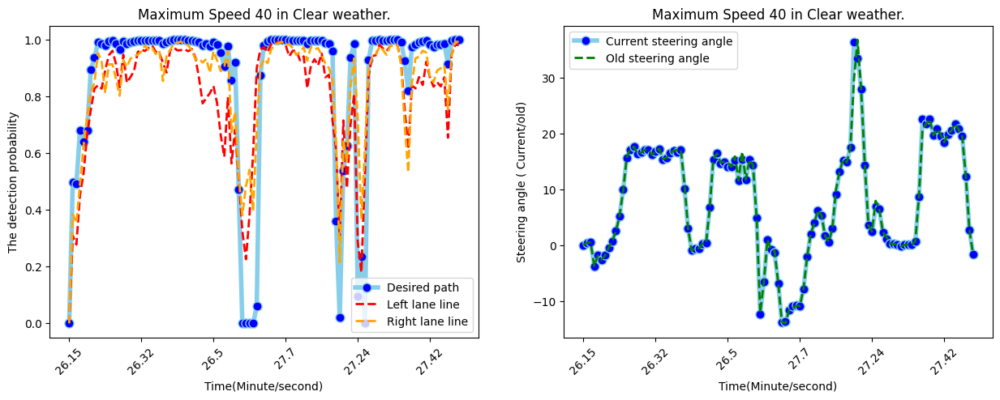

In [21]:
df,max_speed,odd,lead = calculateDataFrameToDraw (df_leadV_clearW_40,40,'Clear',True)
drawFigure(df,max_speed,odd,lead)